# Cluster Analisis
## Inteligencia Computacional 2021-2, Grupo 8a
Nicolás Canales, Matías Vergara

Este notebook tiene por objetivo aplicar métricas sobre los clusters obtenidos al utilizar DAGMM sobre un cuello de botella bidimensional. También se realizará un estudio de los principales clusters obtenidos.

Recordemos que los objetos con los que estamos trabajando son aquellos de tipo periódico, clasificados por ALeRCE como: "LPV", "Periodic-Other", "RRL", "CEP", "E" o "DSCT". 


### Referencias:
J. Amat, Detección de anomalías con Gaussian Mixture Model (GMM) y Python. Diciembre 2020. www.cienciadedatos.net

# Librerías necesarias

In [ ]:
# Tratamiento de datos
# ==============================================================================
import numpy as np
import pandas as pd
import itertools

# Gráficos
# ==============================================================================
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns
import plotly.express as px
import sklearn.metrics as metrics
#style.use('ggplot') or plt.style.use('ggplot')

%matplotlib inline

# Traer la data de clusters

In [ ]:
#!gdown --id 11_zfSwkPI4lFZcLvZHdhIzy_lZ1I-B8i #experimento 18 - 6 components
#!gdown --id 1YgUNskKDGmHyqfebdfOJxXt6i4C3hB7z #experimento 18 - 27 components

!gdown --id 1_7cXC7lPI70i5QN8Rnhm4HjtLVAj0jIk #experimento 27 - 6 components
!gdown --id 1VEHG3xr8Y-e7sYFSG9GBvQ7YS_VJw7Pf #experimento 27 - 30 components

!gdown --id 1C9U3PTGkF24bd2JOMNSNgqK1klmsQ7os #experimento 32 - 6 components
!gdown --id 1gYLjlSyXkxPcZMle_eZ_3cKkr7AbPiBh #experimento 32 - 35 components

!gdown --id 1Qft7rpEX-2TbFik1LrBdxmjlOpJ9ZqeH #experimento UMAP - 6 components
!gdown --id 1ZYbR-haRzy1tNDQUQdpPj9Rz-a0nHRzS #experimento UMAP - 35 components

Downloading...
From: https://drive.google.com/uc?id=1_7cXC7lPI70i5QN8Rnhm4HjtLVAj0jIk
To: /content/expEXTRA_6_components.csv
100% 4.28M/4.28M [00:00<00:00, 62.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1VEHG3xr8Y-e7sYFSG9GBvQ7YS_VJw7Pf
To: /content/expEXTRA_30_components.csv
100% 4.33M/4.33M [00:00<00:00, 67.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1C9U3PTGkF24bd2JOMNSNgqK1klmsQ7os
To: /content/AUTOENCODER_6comp.csv
100% 5.85M/5.85M [00:00<00:00, 92.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1gYLjlSyXkxPcZMle_eZ_3cKkr7AbPiBh
To: /content/AUTOENCODER_35comp.csv
100% 5.91M/5.91M [00:00<00:00, 51.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=1Qft7rpEX-2TbFik1LrBdxmjlOpJ9ZqeH
To: /content/UMAP_6comp.csv
100% 4.23M/4.23M [00:00<00:00, 65.1MB/s]
Downloading...
From: https://drive.google.com/uc?id=1ZYbR-haRzy1tNDQUQdpPj9Rz-a0nHRzS
To: /content/UMAP_35comp.csv
100% 4.29M/4.29M [00:00<00:00, 23.6MB/s]


In [ ]:
#exp18_6c = pd.read_csv("exp18_6_components.csv", index_col=0)
#exp18_27c = pd.read_csv("exp18_27_components.csv", index_col=0)
#exp24_6c = pd.read_csv("exp24_6_components.csv", index_col=0)
#exp24_30c = pd.read_csv("exp24_30_components.csv", index_col=0)
expAC_6c = pd.read_csv("AUTOENCODER_6comp.csv", index_col=0)
expAC_35c = pd.read_csv("AUTOENCODER_35comp.csv", index_col=0)
expUMAP_6c = pd.read_csv("UMAP_6comp.csv", index_col=0)
expUMAP_35c = pd.read_csv("UMAP_35comp.csv", index_col=0)

clusters = [expAC_6c, expAC_35c, expUMAP_6c, expUMAP_35c]

# Funcioes de visualización

In [ ]:
def plot_compare(df):
  df['Componente principal']=df['Componente principal'].astype(str)
  fig = px.scatter(df, x='x', y='y',
                title="Embedding de curvas de luz, colores según clase ALeRCE",
                color='target', opacity=0.3, hover_name="oid.1",
                labels={"Componente principal": "Cluster"})
  fig.show()

  fig2 = px.scatter(df, x='x', y='y', hover_name="oid.1", hover_data=["target"],
                color='Componente principal', opacity=0.3,
                title="Embedding de curvas de luz, color según cluster de mayor probabilidad predicha",
                labels={"Componente principal": "Cluster"})
  fig2.show()

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

# Funciones para métricas


## Métricas de clustering

In [ ]:
# metrics.silhouette_score(X, labels, *, metric='euclidean', sample_size=None, random_state=None, **kwds)
# metrics.davies_bouldin_score(X, labels)

def silhouette(X):
  features = X.drop(labels=["oid.1", "target","Componente principal", "predicted"], axis=1)
  labels = X["Componente principal"]
  score = metrics.silhouette_score(features, labels)
  return score

def dunns(X):
  features = X.drop(labels=["oid.1", "target","Componente principal", "predicted"], axis=1)
  labels = X["Componente principal"]
  score = metrics.davies_bouldin_score(features, labels)
  return score

## Métricas de clasificación


Para aplicar métricas de clasificación, primero tendremos que adaptar la data para indicar a qué clase asociaremos cada cluster. 

In [ ]:
def associate_cluster(X, clusters, classes):
  for j, row in X.iterrows():
    row_cluster = int(row['Componente principal'])
    index = clusters.index(row_cluster)
    pred_class = classes[index]
    X.at[j, 'predicted'] = pred_class

Ahora creamos nuestras funciones para métricas de clasificación


In [ ]:
# Recall 
def recall(X):
  target = X["target"].to_numpy()
  pred = X["predicted"].to_numpy()
  score = metrics.recall_score(target, pred, average="micro")
  return score

#F1-Score
def F1(X):
  target = X["target"]
  pred = X["predicted"]
  score = metrics.f1_score(target, pred, average="micro")
  return score
  
#Confusion matrix (acc)
def conf_mat(X, normalize=True):
  target = X["target"]
  pred = X["predicted"]
  score = metrics.confusion_matrix(target, pred)
  return score
  

# Aplicando metricas sobre cada cluster

## Exp AUTOENCODER - 6 components

Primero visualizaremos la data para ver a qué número de cluster asociamos cada clase.

In [ ]:
df = expAC_6c
plot_compare(df)

Asignamos a cada cluster en la segunda figura un cluster en la primera. 

In [ ]:
pred_class = ["E", "LPV", "RRL", "E", "RRL", "RRL"]
clusters = [0, 1, 2, 3, 4, 5]
associate_cluster(df,  clusters, pred_class)

Calculamos métricas de clustering

In [ ]:
print("Silhouette: ", silhouette(df))
print("Dunns: ", dunns(df))

Silhouette:  0.3154647007230059
Dunns:  0.9888842259115421


Calculamos métricas de clasificación

Recall:  0.5372317307891306
F1-Score:  0.5372317307891306
Normalized confusion matrix
[[0.         0.         0.02889825 0.69717038 0.         0.27393137]
 [0.         0.         0.97754491 0.00598802 0.         0.01646707]
 [0.         0.         0.66320253 0.04345099 0.         0.29334647]
 [0.         0.         0.04031024 0.42371671 0.         0.53597306]
 [0.         0.         0.20333564 0.37020394 0.         0.42646042]
 [0.         0.         0.09368421 0.03850594 0.         0.86780985]]


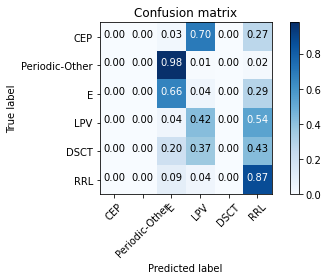

In [ ]:
print("Recall: ", recall(df))
print("F1-Score: ", F1(df))
cf = conf_mat(df)
plot_confusion_matrix(cf, 
                      classes=['CEP', 'Periodic-Other', 'E', 'LPV', 'DSCT', 'RRL'],
                      normalize=True,
                      title='Confusion matrix')

## Exp AUTOENCODER - 35 components

Primero visualizaremos la data para ver a qué número de cluster asociamos cada clase.

In [ ]:
df = expAC_35c
plot_compare(df)

Asignamos a cada cluster en la segunda figura un cluster en la primera. 

In [ ]:
pred_class = ["E", "LPV", "RRL", "RRL", "E", "DSCT", "LPV", "E", "LPV", "RRL", "E", "E", "DSCT", "RRL", "Periodic-Other", "RRL", "RRL", "DSCT",
              "E", "E", "RRL", "RRL", "LPV", "RRL", "LPV", "E", "RRL", "DSCT", "E", "Periodic-Other", "RRL", "RRL", "E", "DSCT", "CEP"]
clusters = list(range(0, 35))
associate_cluster(df,  clusters, pred_class)

Calculamos métricas de clustering

In [ ]:
print("Silhouette: ", silhouette(df))
print("Dunns: ", dunns(df))

Silhouette:  0.3127549460030285
Dunns:  0.9124157614660054


Calculamos métricas de clasificación

Recall:  0.6935884434694427
F1-Score:  0.6935884434694427
Normalized confusion matrix
[[2.98013245e-01 1.10375276e-02 1.98675497e-02 3.48986554e-01
  1.01545254e-01 2.20549870e-01]
 [0.00000000e+00 8.31382689e-01 1.53647251e-01 1.49700599e-03
  1.49700599e-03 1.19760479e-02]
 [5.64414979e-03 4.05841247e-02 7.33261662e-01 1.78582094e-02
  8.86937825e-03 1.93782476e-01]
 [6.41902235e-02 4.08204919e-03 3.09215226e-02 8.15593428e-01
  5.33727931e-02 3.18399837e-02]
 [1.04044245e-01 4.21707570e-02 1.68337366e-01 3.55686139e-01
  1.36622883e-01 1.93138610e-01]
 [5.43293718e-04 2.56027165e-02 7.35823430e-02 1.38200340e-02
  2.71646859e-02 8.59286927e-01]]


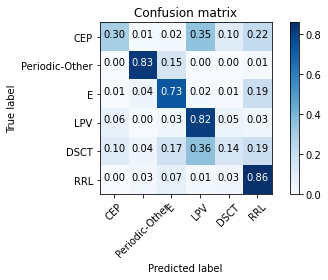

In [ ]:
print("Recall: ", recall(df))
print("F1-Score: ", F1(df))
cf = conf_mat(df)
plot_confusion_matrix(cf, 
                      classes=['CEP', 'Periodic-Other', 'E', 'LPV', 'DSCT', 'RRL'],
                      normalize=True,
                      title='Confusion matrix')

## Exp UMAP - 6 components

Primero visualizaremos la data para ver a qué número de cluster asociamos cada clase.

In [ ]:
df = expUMAP_6c
df = df.rename(columns={'oid': 'oid.1'})
plot_compare(df)

Asignamos a cada cluster en la segunda figura un cluster en la primera.

In [ ]:
pred_class = ["RRL", "LPV", "CEP", "RRL", "E", "E"]
clusters = [0, 1, 2, 3, 4, 5]
associate_cluster(df,  clusters, pred_class)

Calculamos métricas de clustering

In [ ]:
print("Silhouette: ", silhouette(df))
print("Dunns: ", dunns(df))

Silhouette:  0.36001485788177495
Dunns:  0.8918433751363088


Calculamos métricas de clasificación

Recall:  0.5246072973364515
F1-Score:  0.5246072973364515
Normalized confusion matrix
[[0.66044551 0.         0.03230985 0.23178808 0.         0.07545655]
 [0.00598802 0.         0.70019053 0.00149701 0.         0.29232444]
 [0.05094666 0.         0.57262737 0.01758944 0.         0.35883653]
 [0.2408409  0.         0.03194203 0.68741708 0.         0.03979998]
 [0.29865192 0.         0.14630142 0.33408227 0.         0.2209644 ]
 [0.10679117 0.         0.09789474 0.06543294 0.         0.72988115]]


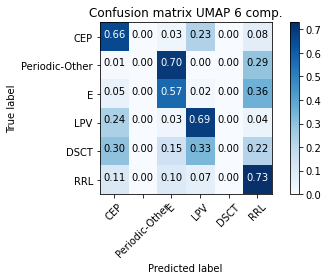

In [ ]:
print("Recall: ", recall(df))
print("F1-Score: ", F1(df))
cf = conf_mat(df)
plot_confusion_matrix(cf, 
                      classes=['CEP', 'Periodic-Other', 'E', 'LPV', 'DSCT', 'RRL'],
                      normalize=True,
                      title='Confusion matrix UMAP 6 comp.')

## Exp UMAP - 35 components

Primero visualizaremos la data para ver a qué número de cluster asociamos cada clase.

In [ ]:
df = expUMAP_35c
df = df.rename(columns={'oid': 'oid.1'})
plot_compare(df)

Asignamos a cada cluster en la segunda figura un cluster en la primera.


In [ ]:
pred_class = ["E", "CEP", "Periodic-Other", "Periodic-Other", "RRL", "DSCT", "E", "E", "Periodic-Other", "E", "E", "E", "E", "LPV", "RRL", "RRL", "E", "RRL",
              "RRL", "CEP", "RRL", "E", "DSCT",  "LPV", "RRL", "CEP", "E", "DSCT", "E", "LPV", "Periodic-Other", "RRL", "RRL", "RRL", "E"]
clusters = list(range(0, 35))
associate_cluster(df,  clusters, pred_class)

Calculamos métricas de clustering

In [ ]:
print("Silhouette: ", silhouette(df))
print("Dunns: ", dunns(df))

Silhouette:  0.32706266525604993
Dunns:  0.8392598538246342


Calculamos métricas de clasificación

Recall:  0.7144808460439993
F1-Score:  0.7144808460439993
Normalized confusion matrix
[[4.23239013e-01 8.83002208e-03 3.11057596e-02 2.60887016e-02
  4.29861529e-01 8.08749749e-02]
 [2.04137180e-03 7.18290691e-01 2.68100163e-01 0.00000000e+00
  1.49700599e-03 1.00707676e-02]
 [2.37412650e-02 2.20091979e-02 8.13504151e-01 3.58358717e-04
  3.75082124e-02 1.02878815e-01]
 [9.65404633e-02 7.65384223e-03 3.56158792e-02 6.70884784e-01
  1.75630166e-01 1.36748648e-02]
 [1.88645005e-01 2.36778431e-02 2.21742136e-01 2.23816108e-02
  4.27929485e-01 1.15623920e-01]
 [1.42275042e-02 8.38709677e-03 1.18607810e-01 6.79117148e-05
  8.13921902e-02 7.77317487e-01]]


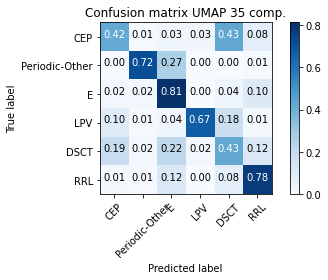

In [ ]:
print("Recall: ", recall(df))
print("F1-Score: ", F1(df))
cf = conf_mat(df)
plot_confusion_matrix(cf, 
                      classes=['CEP', 'Periodic-Other', 'E', 'LPV', 'DSCT', 'RRL'],
                      normalize=True,
                      title='Confusion matrix UMAP 35 comp.')